In [ ]:
import pandas as pd
import matplotlib.pyplot as plt
%matplotlib inline

In [ ]:
import numpy as np

In [ ]:
#!unzip "/content/drive/MyDrive/dog-breed-identification.zip" -d "/content/drive/MyDrive/dog_breed_detection/"

In [ ]:
import tensorflow as tf

In [ ]:
print(tf.__version__)

2.12.0


In [ ]:
import tensorflow_hub as hub

Ab hame ye check krna hai ki hamare pas gpu hai ya ni kyunki is model me images train krni hai

In [ ]:
print("present" if tf.config.list_physical_devices("GPU") else "not")

not


In [ ]:
dt=pd.read_csv("/content/drive/MyDrive/dog_breed_detection/labels.csv")

In [ ]:
dt

,id,breed
0,000bec180eb18c7604dcecc8fe0dba07,boston_bull
1,001513dfcb2ffafc82cccf4d8bbaba97,dingo
2,001cdf01b096e06d78e9e5112d419397,pekinese
3,00214f311d5d2247d5dfe4fe24b2303d,bluetick
4,0021f9ceb3235effd7fcde7f7538ed62,golden_retriever
...,...,...
10217,ffd25009d635cfd16e793503ac5edef0,borzoi
10218,ffd3f636f7f379c51ba3648a9ff8254f,dandie_dinmont
10219,ffe2ca6c940cddfee68fa3cc6c63213f,airedale
10220,ffe5f6d8e2bff356e9482a80a6e29aac,miniature_pinscher


<Axes: >

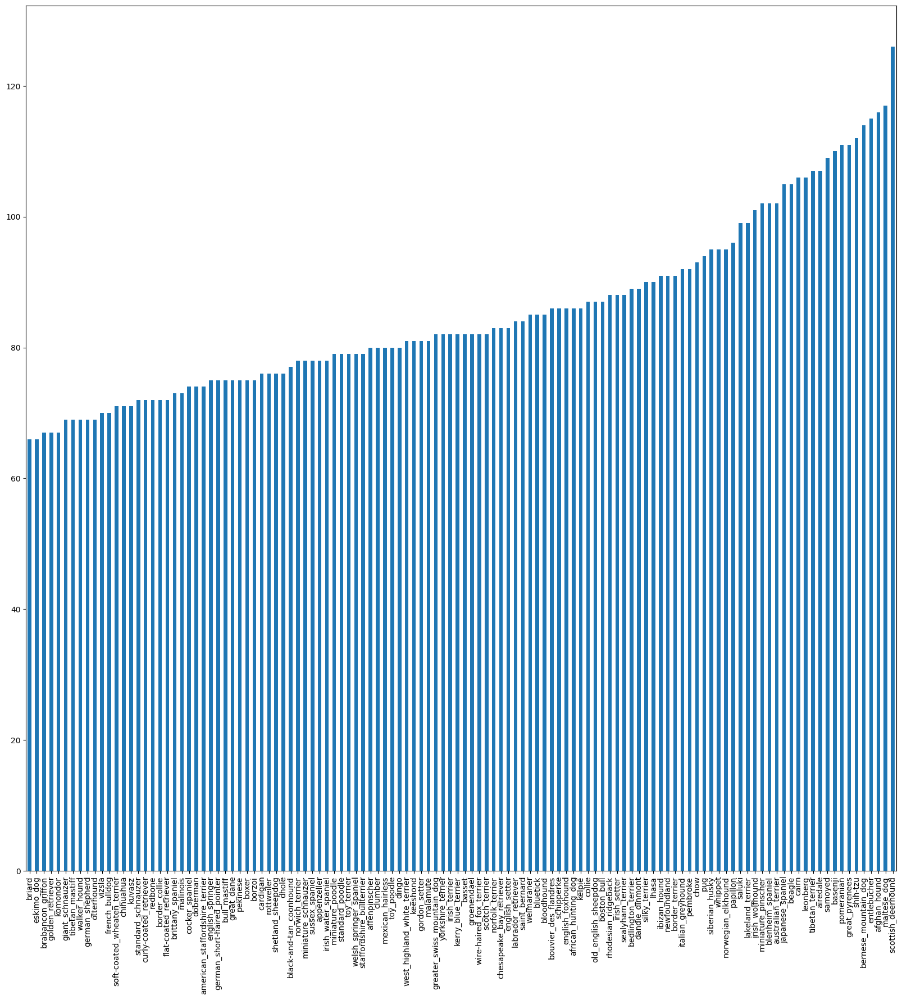

In [ ]:
dt["breed"].value_counts().sort_values().plot.bar(figsize=(20,20))

In [ ]:
from IPython.display import Image

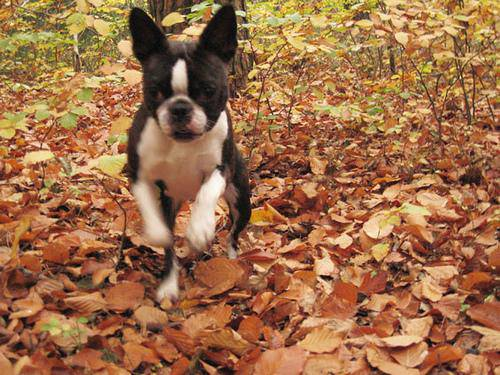

In [ ]:
Image("/content/drive/MyDrive/dog_breed_detection/train/000bec180eb18c7604dcecc8fe0dba07.jpg")

In [ ]:
filename=["/content/drive/MyDrive/dog_breed_detection/train/"+fname+'.jpg' for fname in dt["id"]]

In [ ]:
filename

['/content/drive/MyDrive/dog_breed_detection/train/000bec180eb18c7604dcecc8fe0dba07.jpg',
 '/content/drive/MyDrive/dog_breed_detection/train/001513dfcb2ffafc82cccf4d8bbaba97.jpg',
 '/content/drive/MyDrive/dog_breed_detection/train/001cdf01b096e06d78e9e5112d419397.jpg',
 '/content/drive/MyDrive/dog_breed_detection/train/00214f311d5d2247d5dfe4fe24b2303d.jpg',
 '/content/drive/MyDrive/dog_breed_detection/train/0021f9ceb3235effd7fcde7f7538ed62.jpg',
 '/content/drive/MyDrive/dog_breed_detection/train/002211c81b498ef88e1b40b9abf84e1d.jpg',
 '/content/drive/MyDrive/dog_breed_detection/train/00290d3e1fdd27226ba27a8ce248ce85.jpg',
 '/content/drive/MyDrive/dog_breed_detection/train/002a283a315af96eaea0e28e7163b21b.jpg',
 '/content/drive/MyDrive/dog_breed_detection/train/003df8b8a8b05244b1d920bb6cf451f9.jpg',
 '/content/drive/MyDrive/dog_breed_detection/train/0042188c895a2f14ef64a918ed9c7b64.jpg',
 '/content/drive/MyDrive/dog_breed_detection/train/004396df1acd0f1247b740ca2b14616e.jpg',
 '/content

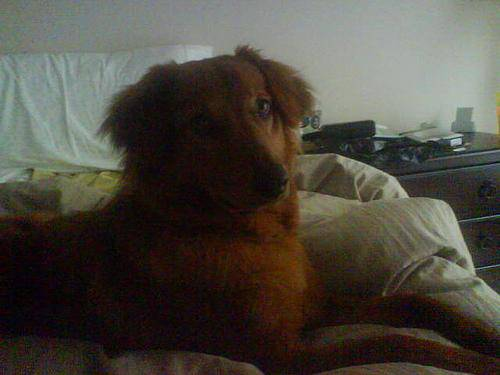

In [ ]:
Image(filename[1000])

In [ ]:
dt["breed"][1000]

'irish_setter'

In [ ]:
uniq=np.array(dt["breed"].unique())

In [ ]:
bool_labels=np.array([label==uniq for label in dt["breed"]])

In [ ]:
bool_labels.shape

(10222, 120)

In [ ]:
n = 10000 #@param {type:"slider", min:1000, max:10000, step:1000}

In [ ]:
from sklearn.model_selection import train_test_split
x_train,x_val,y_train,y_val=train_test_split(filename[:n],bool_labels[:n],train_size=0.8,random_state=42)

In [ ]:
len(x_train),len(x_val),len(y_train),len(y_val)

(8000, 2000, 8000, 2000)

**Preprocessing Images**
*   We need to convert image to tensor
*   Take image file path as input
*   Use Tensorflow to read file and save image as a variable
*   Turn image into Tensors
*   Resize image to (224,224)
*   Return modified image




In [ ]:
from matplotlib.pyplot import imread
ig=imread(filename[22])

In [ ]:
ig

array([[[ 23,   0,  10],
        [ 23,   0,  10],
        [ 24,   1,  11],
        ...,
        [109,  43,  29],
        [ 80,  24,   7],
        [ 54,   3,   0]],

       [[ 70,  53,  61],
        [ 67,  50,  58],
        [ 59,  42,  50],
        ...,
        [100,  40,  30],
        [ 79,  27,  16],
        [ 57,   9,   0]],

       [[116, 106, 114],
        [113, 103, 111],
        [106,  96, 104],
        ...,
        [ 92,  42,  41],
        [ 81,  37,  36],
        [ 57,  16,  14]],

       ...,

       [[127, 126,  44],
        [122, 121,  39],
        [127, 126,  46],
        ...,
        [140, 126,  53],
        [139, 125,  52],
        [136, 122,  51]],

       [[123, 122,  40],
        [117, 116,  34],
        [123, 122,  42],
        ...,
        [145, 131,  58],
        [146, 132,  61],
        [156, 142,  71]],

       [[123, 122,  40],
        [117, 116,  34],
        [123, 122,  42],
        ...,
        [145, 131,  58],
        [146, 132,  61],
        [156, 142,  71]]

Now creating a function for converting image into Tensors

In [ ]:
def process_image(image_pt):
  image_size=224;
  # reading the image
  ig=tf.io.read_file(image_pt)
  # turn img into numerical tensor with 3 colour channels
  ig=tf.image.decode_image(ig,channels=3,expand_animations=False)
  # now normalising the calues ie converting from range of 0-255 int to 0-1 float
  ig=tf.image.convert_image_dtype(ig,tf.float32)
  # now resizing
  ig=tf.image.resize(ig,[image_size,image_size])
  return ig

In [ ]:
# Now we need to convert data into tupple of processed image and label
def to_tupple(img,label):
  return process_image(img),label

In [ ]:
process_image(filename[2])

<tf.Tensor: shape=(224, 224, 3), dtype=float32, numpy=
array([[[0.3918853 , 0.3918853 , 0.36051273],
        [0.43775532, 0.43775532, 0.40638277],
        [0.44351017, 0.44351017, 0.41213763],
        ...,
        [0.05796662, 0.02239764, 0.01937653],
        [0.05252095, 0.0470589 , 0.04978992],
        [0.04586835, 0.05371149, 0.04978992]],

       [[0.38653433, 0.38261276, 0.3630049 ],
        [0.4161569 , 0.41223532, 0.39262748],
        [0.43315482, 0.42923325, 0.4096254 ],
        ...,
        [0.0909924 , 0.05177672, 0.04754004],
        [0.03035708, 0.02489503, 0.02762605],
        [0.02370449, 0.03154762, 0.02762605]],

       [[0.36859888, 0.3646773 , 0.34506944],
        [0.35422263, 0.35030106, 0.33069322],
        [0.39899355, 0.39507198, 0.3754641 ],
        ...,
        [0.2361781 , 0.20233706, 0.19541305],
        [0.04896353, 0.04268564, 0.04582458],
        [0.04459034, 0.04705883, 0.04582458]],

       ...,

       [[0.7591447 , 0.75522316, 0.7356153 ],
        [0.74

**Now we need to divide data into batches**
Because there are a lot of images in the dataset we are using it might exceed the memory limit of gpu
So we need to divide it in batches of fixed size preferrably 32 to effeciently use tensor flow to train data
Also when feeding the data it will have to be in form
**(processed image,label in form of tensor**)

In [ ]:
# Now we have to convert to batches so we make a function
# for training data set we would need both label and processed image and also to shuffle it for more optimal training
# for validation data we would need both label and processed image
# for test data we would only need processed image
def to_batches(x,y=None,batch_size=32,is_test=False,is_valid=False):
  if is_test:
    x=tf.data.Dataset.from_tensor_slices((tf.constant(x)))
    x=x.map(process_image)
    x=x.batch(32)
  elif is_valid:
    x=tf.data.Dataset.from_tensor_slices((tf.constant(x),tf.constant(y)))
    x=x.map(to_tupple)
    x=x.batch(32)
  else:
     x=tf.data.Dataset.from_tensor_slices((tf.constant(x),tf.constant(y)))
     x=x.shuffle(buffer_size=len(x))
     x=x.map(to_tupple)
     x=x.batch(32)
  return x;


In [ ]:
train_data=to_batches(x_train,y_train)
val_data=to_batches(x_val,y_val,is_valid=True)

In [ ]:
train_data.element_spec,val_data.element_spec

((TensorSpec(shape=(None, 224, 224, 3), dtype=tf.float32, name=None),
  TensorSpec(shape=(None, 120), dtype=tf.bool, name=None)),
 (TensorSpec(shape=(None, 224, 224, 3), dtype=tf.float32, name=None),
  TensorSpec(shape=(None, 120), dtype=tf.bool, name=None)))

In [ ]:
t_ig,t_lb=next(train_data.as_numpy_iterator())

In [ ]:
# now to represent our data we wil create a function
def re_data(images,label):
  # we will print 25 images
  fig,ax=plt.subplots(5,5,figsize=(20,20))
  x=0

  for i in range(5):
    for j in range(5):
      ax[i,j].imshow(images[x])

      ax[i,j].set_title(uniq[label[x].argmax()])
      ax[i,j].axis('off')
      x=x+1


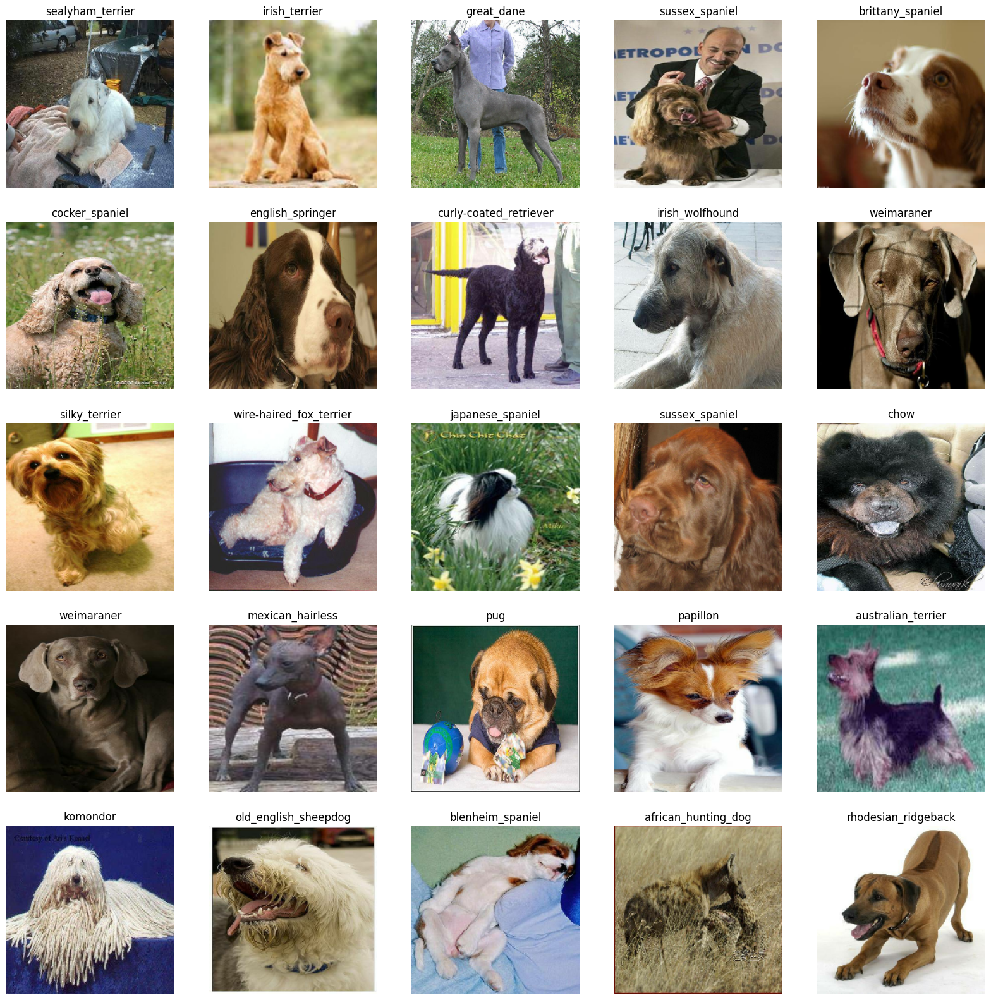

In [ ]:
re_data(t_ig,t_lb)

Now since out data is ready we need to confirm three things
* Input Shape = (0,224,224,3) i.e. shape of tensor data
* Ouput Shape=len(uniq) i.e. because we will need true and false labels
* Model =https://tfhub.dev/google/imagenet/mobilenet_v2_130_224/classification/5

Now since we have decided on input output and model
* Describe layer in keras model in sequential manner
* Compile the model
* Build the model
* Return the model

In [ ]:
# Building function to build keras model
mdl="https://tfhub.dev/google/imagenet/mobilenet_v2_130_224/classification/5"
def build_model(input_shape=[None,224,224,3],output_shape=len(uniq),model_url=mdl):
  model=tf.keras.Sequential([hub.KerasLayer(model_url),tf.keras.layers.Dense(units=output_shape,activation="softmax")])
  model.compile(loss=tf.keras.losses.CategoricalCrossentropy(),
                optimizer=tf.keras.optimizers.Adam(),
                metrics=["accuracy"]
               )
  model.build(input_shape)
  return model

In [ ]:
# md=build_model()

In [ ]:
# md.summary()

**CALLBACKS**
* Ab jaise manle terko progress save krni hai, progress check krni hai ya training jo hai model ki wo jaldi rok deni hai to in cases me call back ka use kia jata hai
* https://www.tensorflow.org/guide/keras/writing_your_own_callbacks
To ab hame do type ke call backs chahiyen ek to model ka progress check krne ke liye dusra if we have to model ko jaldi stop krne ke liye
Pehle purpose ke liye
* Tensor Board-> https://www.tensorflow.org/tensorboard
*  Ab isko setup krne krne ke liye hame 3 cheeze chahiye
-> pehli to TensorBoard notebook extension
->TensorBoaed callback which is able to save logs to a directory and pass to model's fit function
-> Visualize these logs with Tensor board magic funtion


In [ ]:
# Load tensorboard notebook extension
%load_ext tensorboard

In [ ]:
import datetime
import os
# Ab logs rkhne ka best tarika time ke saath hai
def create_tnsorboard_callback():
  logdir=os.path.join("/content/drive/MyDrive/dog_breed_detection/logs",datetime.datetime.now().strftime("%Y%m%d-%H%M%s"))
  return tf.keras.callbacks.TensorBoard(logdir)

**Early Stopping Callback**
Ab manle tune koi model train kara aur wo itna train hogya ki aur uska metric improve nahi hora. Ab aise cases me kai baar wo model train data ke pattern me itna train ho jata hai ki wo aur external data pe generalize hi ni kar pata i.e. uske ratte lag jate hai



In [ ]:
earlystpng=tf.keras.callbacks.EarlyStopping(monitor="val_accuracy",patience=3)

**Epochs** -> Epochs matlab tera model kitna data ke upar iterate krega

In [ ]:
#Creating a slider for number of epochs
num_ep=100# @param{type: "slider",min: 10,max: 100}

In [ ]:
print("yes" if tf.config.list_physical_devices("GPU") else "NO")

NO


 Now let's train a model
*   Create a function using build_model
*   Create a tensorboard call back
*   Call fir on training and validation data and number of epochs and callbacks we would like to use
* return model



In [ ]:
def train_model():
  md=build_model()
  tb_cb=create_tnsorboard_callback()
  md.fit(epochs=num_ep,x=train_data,validation_data=val_data,
         validation_freq=1, # matlab ek epoch me kitni bar data validate hoga
         callbacks=[tb_cb,earlystpng]
         )
  return md

In [ ]:

# md=train_model()

Ab dekh moddl hora hai overfit. To ab iska krna pdega nivaran. Iske liye chahiye hame do cheeze.
* Pehla kya hai iska karan

> The training data size is too small and does not contain enough data samples to accurately represent all possible input data values. The training data contains large amounts of irrelevant information, called noisy data.


* Aur dusra kya hai iska niwaran


> https://aws.amazon.com/what-is/overfitting/

# New Section

In [ ]:
# Ab chalo tensorflow logs check krte hai uska magin function use krke
%tensorboard --logdir drive/MyDrive/dog_breed_detection/logs

<IPython.core.display.Javascript object>

In [ ]:

# re=md.predict(val_data)
def led_mdl(path):
  return tf.keras.models.load_model(path,custom_objects={"KerasLayer": hub.KerasLayer})
md=led_mdl("/content/drive/MyDrive/dog_breed_detection/models/20230617-0550168698100710000_100_imgages_mbilenetv2_adam_optimizer.h5")
re=md.predict(val_data)

63/63 [==============================] - 194s 3s/step


In [ ]:
# Now we want to display the result properly with image and with original label but problem with that is we have data in form of batches so we need to convert it back to original images and label
# So we will use unbatch function
def n_unb():
  return list(val_data.unbatch().as_numpy_iterator())

In [ ]:
val_ub=n_unb()
def get_re(index=0):
  plt.imshow(val_ub[index][0])
  plt.axis('off')
  print("Max Probability ",re[index].max())
  print("Predicted Label ",uniq[re[index].argmax()])
  print("Actual Label ",uniq[val_ub[index][1].argmax()])

Max Probability  0.96886176
Predicted Label  italian_greyhound
Actual Label  whippet


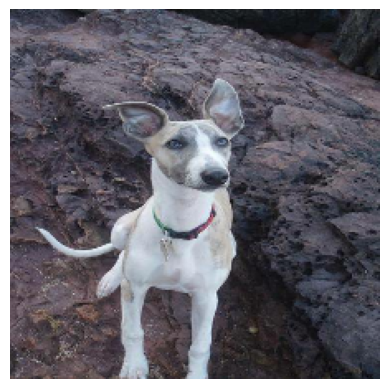

In [ ]:
get_re(15)

In [ ]:
# Now for plotting top 10 predicted values
def plt_gp10(index=0,re=[]):
  fig,axs=plt.subplots(nrows=1,ncols=2,figsize=(20,5))
  axs[0].imshow(val_ub[index][0])
  axs[0].axis('off')
  # print("Max Probability ",re[index].max())
  # print("Predicted Label ",uniq[re[index].argmax()])
  # print("Actual Label ",uniq[val_ub[index][1].argmax()])
  te=re[index].argsort()[-10:]
 # print(te)
  #print(re[index][42],re[index][33])
  lbls=uniq[te]
  tp_plt=axs[1].barh(uniq[te],re[index][te],color="grey")
  tr_lb=uniq[val_ub[index][1].argmax()]
  if np.isin(
      tr_lb, #value to be found
       lbls #in which value is to be found
           ):
    tp_plt[np.argmax(lbls==tr_lb)].set_color("green")

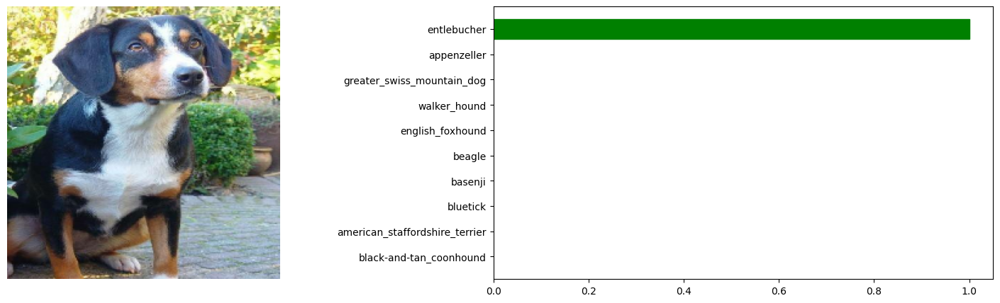

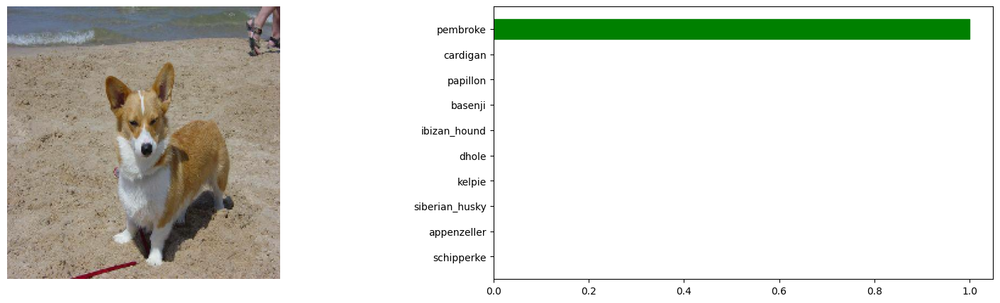

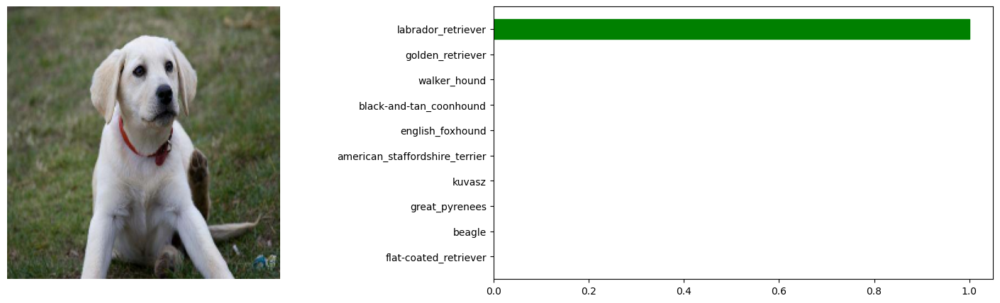

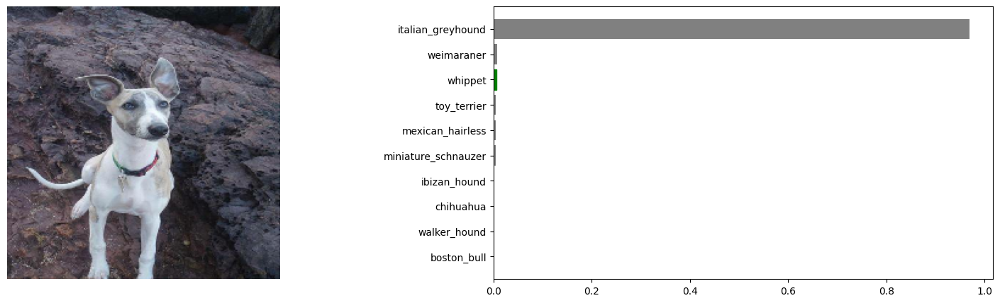

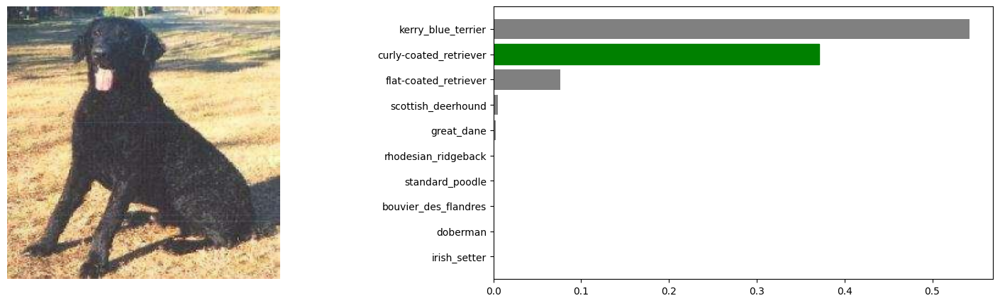

...

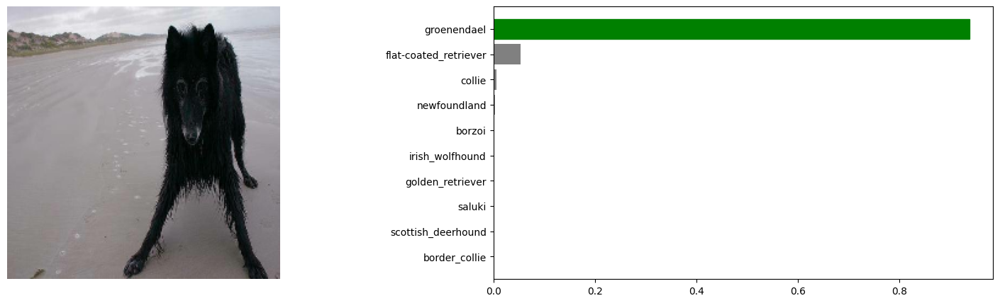

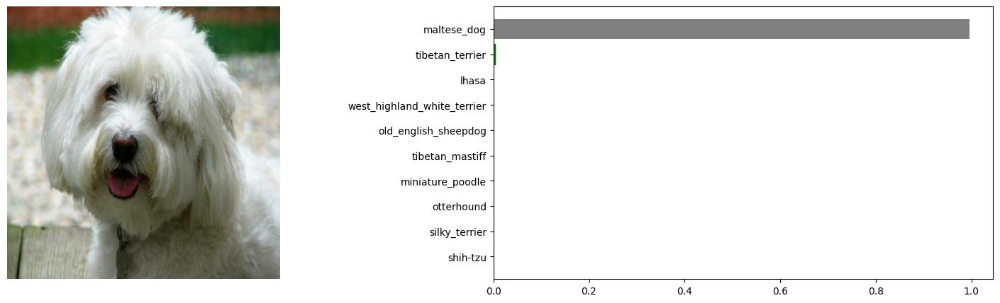

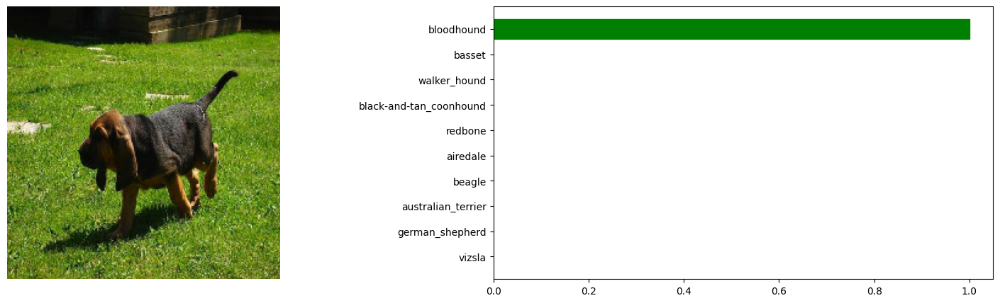

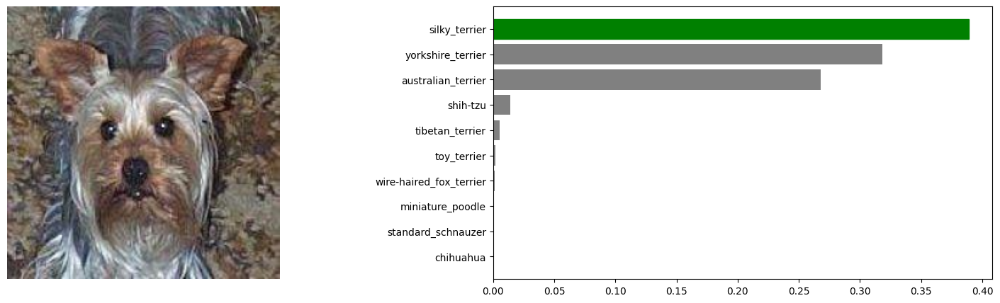

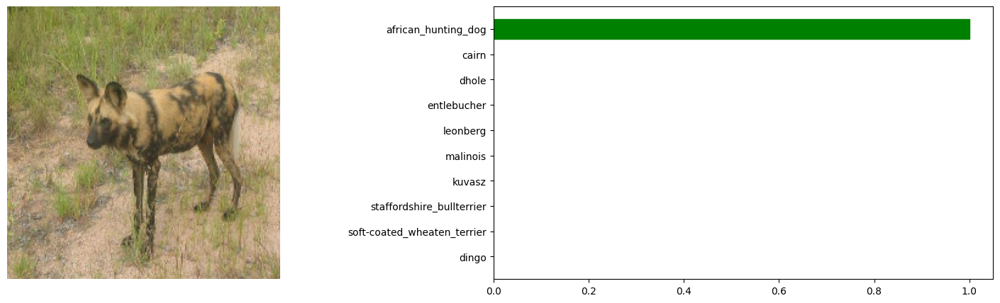

In [ ]:
for i in range(0,100,5):
  plt_gp10(i,re)

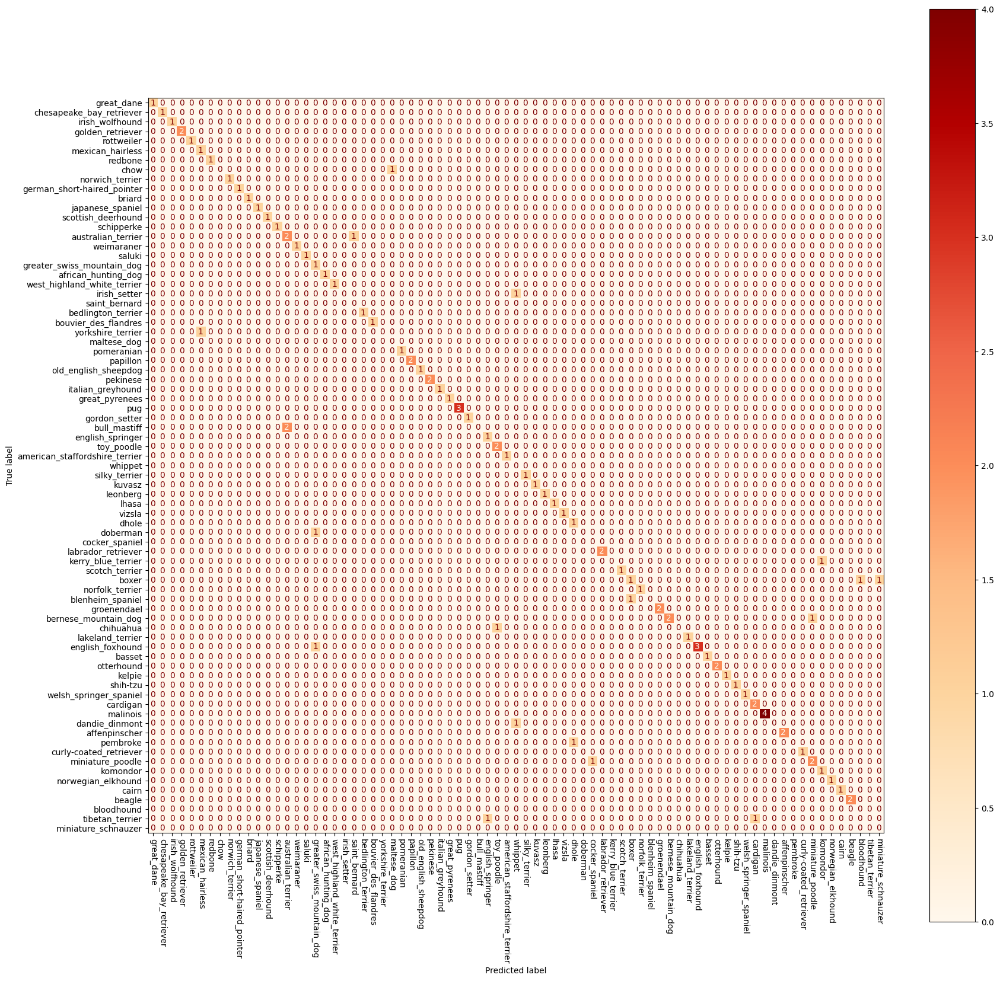

In [ ]:
# Now lets try to make a confusion matrix
from sklearn.metrics import confusion_matrix,ConfusionMatrixDisplay,classification_report
tr_lbls=[]
pr_lbls=[]
lbls=set()
for index in range (1,100):
  pr_lbls.append(uniq[re[index].argmax()])
  lbls.add(uniq[re[index].argmax()])
  tr_lbls.append(uniq[val_ub[index][1].argmax()])
  lbls.add(uniq[val_ub[index][1].argmax()])
cm=confusion_matrix(tr_lbls,pr_lbls)
cm_sh=ConfusionMatrixDisplay(cm,display_labels=list(lbls))
plt.rcParams['figure.figsize'] = (20, 20)
cm_sh.plot(cmap='OrRd',xticks_rotation=-90)


In [ ]:
#Now we have to save this model
def save_mdl(model,suffix=None):
  md_dir=os.path.join("/content/drive/MyDrive/dog_breed_detection/models",datetime.datetime.now().strftime("%Y%m%d-%H%M%s"))
  md_path=md_dir+suffix+".h5"
  model.save(md_path)
  return md_path

In [ ]:
# def led_mdl(path):
#   return tf.keras.models.load_model(path,custom_objects={"KerasLayer": hub.KerasLayer})

In [ ]:
#md_pth=save_mdl(md,str(n)+"_"+str(num_ep)+"_imgages_mbilenetv2_adam_optimizer")

In [ ]:
#new_md=led_mdl(md_pth)

In [ ]:
md.evaluate(val_data)

63/63 [==============================] - 69s 1s/step - loss: 0.7527 - accuracy: 0.8015


[0.7526624798774719, 0.8015000224113464]

In [ ]:
#Now lets test this data
test_data=["/content/drive/MyDrive/dog_breed_detection/test/"+ fname for fname in os.listdir("/content/drive/MyDrive/dog_breed_detection/test") ]

In [ ]:
test_data=to_batches(x=test_data,is_test=True)

In [ ]:
test_data.element_spec,val_data.element_spec

(TensorSpec(shape=(None, 224, 224, 3), dtype=tf.float32, name=None),
 (TensorSpec(shape=(None, 224, 224, 3), dtype=tf.float32, name=None),
  TensorSpec(shape=(None, 120), dtype=tf.bool, name=None)))

In [ ]:
#test_pred=md.predict(test_data)

324/324 [==============================] - 652s 2s/step


In [ ]:
#np.savetxt("/content/drive/MyDrive/dog_breed_detection/tst_res.csv",test_pred,delimiter=",")

In [ ]:
test_pred=np.loadtxt("/content/drive/MyDrive/dog_breed_detection/tst_res.csv",delimiter=",")

In [ ]:
test_pred

array([[1.23623725e-08, 1.61915192e-09, 5.08518451e-06, ...,
        6.87134571e-09, 9.87271376e-10, 3.13166062e-08],
       [2.86157720e-09, 2.14915281e-06, 5.73963348e-08, ...,
        1.51672563e-09, 9.12893405e-09, 1.28031360e-07],
       [9.94180738e-10, 1.52597035e-09, 4.99515651e-10, ...,
        1.72357598e-13, 1.28191988e-11, 3.88247099e-06],
       ...,
       [1.60914553e-08, 1.79923032e-09, 1.94144100e-02, ...,
        4.20999307e-08, 1.76917169e-07, 1.22278729e-08],
       [5.94882010e-07, 9.49410950e-09, 1.81349787e-06, ...,
        2.39685871e-09, 2.15505929e-06, 8.16343348e-09],
       [9.17432862e-06, 1.21684893e-08, 1.23972370e-07, ...,
        1.25788546e-07, 2.90481324e-07, 1.31846009e-05]])

In [ ]:
yuh=pd.DataFrame(columns=["id"]+list(uniq))

In [ ]:
lst=test_data= os.listdir("/content/drive/MyDrive/dog_breed_detection/test")
yuh["id"]=lst
yuh[list(uniq)]=test_pred
yuh

,id,boston_bull,dingo,pekinese,bluetick,golden_retriever,bedlington_terrier,borzoi,basenji,scottish_deerhound,...,blenheim_spaniel,silky_terrier,sussex_spaniel,german_short-haired_pointer,french_bulldog,bouvier_des_flandres,tibetan_mastiff,english_springer,cocker_spaniel,rottweiler
0,e5942b2259c795541cd9ea68fb106406.jpg,1.236237e-08,1.619152e-09,5.085185e-06,2.874974e-08,2.912587e-09,9.510342e-09,1.020214e-07,1.427252e-08,4.289685e-07,...,4.051988e-09,5.635476e-07,2.117905e-08,2.024742e-08,2.266798e-09,1.902305e-08,6.208114e-08,6.871346e-09,9.872714e-10,3.131661e-08
1,e745d75a74a9cbdc917e7775febd88e8.jpg,2.861577e-09,2.149153e-06,5.739633e-08,1.484828e-08,8.278068e-07,9.959587e-11,2.615140e-12,1.781455e-06,2.439684e-10,...,1.784774e-10,1.221447e-08,1.529069e-07,1.169352e-07,1.059234e-10,7.442549e-10,3.724278e-09,1.516726e-09,9.128934e-09,1.280314e-07
2,e4b7ff61849485992246c0f2ab7e8804.jpg,9.941807e-10,1.525970e-09,4.995157e-10,1.428744e-10,3.080358e-09,2.152319e-10,1.641434e-08,2.032397e-08,1.858731e-09,...,2.448175e-11,6.198342e-09,8.351200e-11,3.479613e-10,2.083472e-09,6.254584e-10,2.257647e-10,1.723576e-13,1.281920e-11,3.882471e-06
3,e425ab04e3a0d4464cda46a076964770.jpg,4.861627e-08,2.932308e-09,1.811158e-06,1.948675e-06,1.662328e-05,7.514545e-07,1.035948e-06,4.009300e-08,4.295745e-01,...,2.312566e-05,8.538825e-07,1.363352e-04,3.135113e-09,1.740879e-08,1.131817e-05,1.202352e-07,2.821908e-07,1.228968e-04,4.535214e-10
4,ddf2401701ee374c0f1f9dd607071ec7.jpg,3.327535e-07,1.500099e-08,1.370209e-06,1.060015e-08,7.301495e-08,1.587863e-08,4.740924e-09,6.376669e-08,2.405643e-08,...,3.340161e-07,1.238479e-08,6.103287e-06,9.341105e-08,2.440573e-06,9.085397e-07,8.871291e-06,8.199635e-08,9.278889e-05,1.261649e-07
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
10352,07e4edc428816ffe6b8dd1024bed2782.jpg,1.306380e-06,2.947052e-07,8.133181e-08,1.492127e-05,7.735184e-08,2.925030e-07,5.277132e-08,3.368606e-07,3.412494e-04,...,1.595585e-08,1.083316e-04,1.957874e-06,9.618643e-05,7.075917e-07,3.253478e-05,1.511073e-08,5.458059e-06,6.627764e-07,3.164202e-07
10353,088caa7edc676bfd9ecb154e1cb4d720.jpg,6.525227e-07,4.830134e-13,1.478241e-06,4.574157e-11,2.301761e-10,2.315344e-11,9.058187e-11,1.971622e-11,2.623883e-11,...,1.925667e-06,1.602111e-10,2.884292e-10,1.793759e-10,1.598745e-08,1.233470e-11,1.240849e-11,9.485994e-09,2.218617e-09,2.007451e-14
10354,07be196f3517e9afe16c0ddc61824628.jpg,1.609146e-08,1.799230e-09,1.941441e-02,7.750332e-09,5.610236e-07,1.826584e-10,2.117292e-07,2.763647e-08,1.514896e-08,...,6.571002e-05,1.071999e-06,2.907207e-05,1.860526e-10,1.064421e-07,4.761159e-07,5.212600e-07,4.209993e-08,1.769172e-07,1.222787e-08
10355,093429fa3735918cf4501c167b41aad1.jpg,5.948820e-07,9.494109e-09,1.813498e-06,8.663690e-07,5.141207e-08,6.278458e-12,5.925079e-09,6.173948e-07,4.209550e-08,...,9.590879e-10,7.230494e-10,3.906227e-07,3.040034e-08,1.002754e-06,7.356952e-09,1.922313e-08,2.396859e-09,2.155059e-06,8.163433e-09


In [ ]:
lst=[os.path.splitext(path)[0] for path in os.listdir("/content/drive/MyDrive/dog_breed_detection/test")]

In [ ]:
yuh=yuh.reindex(sorted(yuh.columns),axis=1)

In [ ]:
yuh=yuh.drop("id",axis=1)

In [ ]:
yuh.insert(0,'id',lst)

In [ ]:
yuh=yuh.sort_values(by=['id'])

In [ ]:
yuh

,id,affenpinscher,afghan_hound,african_hunting_dog,airedale,american_staffordshire_terrier,appenzeller,australian_terrier,basenji,basset,...,toy_poodle,toy_terrier,vizsla,walker_hound,weimaraner,welsh_springer_spaniel,west_highland_white_terrier,whippet,wire-haired_fox_terrier,yorkshire_terrier
827,000621fb3cbb32d8935728e48679680e,7.117215e-09,9.453642e-10,1.241907e-06,2.444120e-11,1.444366e-08,4.944047e-09,6.688767e-07,1.923486e-06,3.050812e-07,...,3.105976e-08,1.608426e-07,1.184202e-09,3.676097e-08,2.283917e-08,1.176088e-08,5.863662e-08,1.925771e-09,2.983648e-06,1.785489e-10
937,00102ee9d8eb90812350685311fe5890,9.152696e-13,1.275933e-09,2.782183e-12,3.082656e-10,5.191391e-09,1.645918e-10,7.684182e-09,1.814497e-09,9.381537e-08,...,6.324447e-11,2.258746e-10,3.019128e-06,2.626918e-07,4.338731e-11,4.555945e-11,6.034953e-12,4.327389e-09,2.934790e-12,1.038871e-11
685,0012a730dfa437f5f3613fb75efcd4ce,1.551741e-07,1.845784e-05,5.777600e-08,2.246768e-04,1.698105e-04,9.834227e-06,3.406167e-01,8.364247e-06,2.822818e-07,...,5.836052e-06,1.127246e-05,3.459838e-06,4.044873e-05,4.982572e-07,2.010575e-03,4.034175e-05,4.554724e-08,3.217868e-05,2.383071e-04
633,001510bc8570bbeee98c8d80c8a95ec1,1.449945e-10,1.137558e-11,1.518710e-10,1.723549e-12,3.131941e-05,9.323400e-07,4.174839e-07,9.990471e-01,3.075439e-08,...,1.190822e-09,3.442584e-06,1.590423e-09,5.482781e-08,5.327233e-09,2.133730e-08,2.718805e-07,4.823960e-08,4.333307e-09,1.169144e-10
718,001a5f3114548acdefa3d4da05474c2e,2.094574e-08,1.579616e-09,1.803742e-08,5.527633e-11,8.410452e-08,2.579034e-08,4.837329e-09,2.553507e-07,8.361755e-10,...,2.435047e-07,4.139807e-08,8.860026e-08,4.190076e-08,2.276771e-08,1.254547e-08,8.038771e-09,6.271642e-10,5.308682e-10,6.072082e-09
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
9571,ffeda8623d4eee33c6d1156a2ecbfcf8,6.420688e-11,4.786404e-09,1.055891e-08,9.646857e-10,2.982488e-07,8.635815e-10,1.320418e-06,2.470186e-09,1.624765e-10,...,3.768863e-09,3.275635e-07,1.041543e-09,7.367404e-12,4.225658e-07,3.441701e-10,5.304458e-12,3.538713e-05,2.312850e-09,2.153532e-09
9236,fff1ec9e6e413275984966f745a313b0,8.037559e-01,4.430234e-09,1.272803e-05,1.866507e-09,7.108807e-08,3.840491e-08,3.741299e-04,1.542842e-07,5.645940e-07,...,3.297135e-05,6.731957e-05,2.344884e-06,2.031126e-07,4.983777e-06,6.687101e-09,1.906425e-07,5.718235e-08,3.451056e-06,4.746700e-02
9280,fff74b59b758bbbf13a5793182a9bbe4,3.304333e-08,3.979741e-07,8.299581e-09,5.852333e-04,1.026248e-08,2.963511e-04,1.534918e-08,3.811490e-09,1.418004e-09,...,7.561746e-08,9.847869e-07,4.749967e-07,2.008645e-06,3.805769e-07,3.789529e-07,2.117461e-08,5.111295e-08,3.825938e-10,1.226909e-07
9502,fff7d50d848e8014ac1e9172dc6762a3,7.227369e-09,5.412364e-07,4.066293e-08,3.458255e-07,4.043580e-11,2.636093e-09,3.179741e-09,1.321445e-08,3.889492e-09,...,3.708353e-08,1.437588e-09,3.635437e-10,2.908007e-11,1.409568e-09,6.054868e-11,1.122533e-08,1.479953e-09,1.084366e-07,1.701620e-08


In [ ]:
yuh.to_csv("/content/drive/MyDrive/dog_breed_detection/rs.csv",index=False)